In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import warnings
warnings.filterwarnings('ignore')

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/ttnt-dataset/train.csv
/kaggle/input/ttnt-dataset/test.csv
/kaggle/input/hanoi-ds/Hanoi_LandCover_Data_13_4.csv


In [2]:
df_train = pd.read_csv("/kaggle/input/ttnt-dataset/train.csv")
df_test = pd.read_csv("/kaggle/input/ttnt-dataset/test.csv")

In [3]:
print(f"Train dataset: {df_train.shape[0]} rows, {df_train.shape[1]} columns")
print(f"Test dataset: {df_test.shape[0]} rows, {df_test.shape[1]} columns")

Train dataset: 11400 rows, 16 columns
Test dataset: 2850 rows, 16 columns


In [4]:
df_train.head()

,long,lat,B1,B2,B3,B4,B5,B6,B7,B8,B8A,B9,B10,B11,B12,label
0,105.789453,19.409841,1550.0,1351.5,1223.5,1273.0,1231.0,1419.0,1586.5,1478.5,1742.0,299.0,9.5,2191.5,2011.5,residentialland
1,105.785023,19.740696,1539.0,1458.0,1337.5,1193.0,1306.5,1831.0,2111.5,2202.5,2322.0,387.5,10.5,2361.5,2005.5,residentialland
2,106.021096,19.982862,1617.0,1346.0,1221.0,1021.0,1108.0,1493.0,1709.0,1528.0,1751.0,264.0,9.0,825.0,398.0,aquaculture
3,105.771186,19.321312,1708.5,1474.0,1374.5,1115.0,1060.5,1119.0,1228.5,1046.5,1150.0,141.5,7.5,766.0,539.5,open_water
4,105.802570,19.817704,1856.5,1593.0,1549.5,1436.0,1618.5,2083.0,2303.5,2226.0,2489.0,372.5,11.0,2076.0,1443.5,residentialland


## Display các điểm dữ liệu trên bản đồ

In [5]:
import folium

# Input: 
#       Tập coordinate [(lat_0, lon_0), (lat_1, lon_1), ... (lat_n, lon_n)]
#       Center (lat_center, lon_center)
def display_coordinate(coordinates, center=None, color='red'):
    if center is None:
        center = coordinates[0]
    m = folium.Map(location=[center[0], center[1]], zoom_start=5)
    for lat, lon in coordinates:
        folium.Marker(location=[lat, lon], icon=folium.Icon(color=color)).add_to(m)
    return m

In [6]:
train_coords = list(zip(df_train['lat'],df_test['long']))
display_coordinate(train_coords[:5])

In [7]:
# df_hanoi = pd.read_csv("/kaggle/input/hanoi-ds/Hanoi_LandCover_Data_13_4.csv")

In [8]:
# df_hanoi.head()

In [9]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# plt.figure(figsize=(10, 5))
# sns.countplot(data=df_hanoi, x='Name', order=df_hanoi['Name'].value_counts().index)
# plt.xticks(rotation=45)
# plt.title('Distribution of Name')
# plt.tight_layout()
# plt.show()

## Loại bỏ các trường không cần thiết 
Trường `lat` và `long` không cần thiết cho quá trình huấn luyện dữ liệu nên loại bỏ các cột này

In [10]:
def remove_unused_columns(df, cols):
    df.drop(cols, axis=1, inplace=True, errors='ignore')

In [11]:
remove_unused_columns(df_train, ['Unnamed: 0', 'lat', 'long'])
remove_unused_columns(df_test, ['Unnamed: 0', 'lat', 'long'])

## Phân tích đơn biến (phân tích phân bố)

In [12]:
# List toàn bộ tên các feature trong dataframe
def get_all_features(df):
    return [col for col in df.columns if col.startswith('B')]

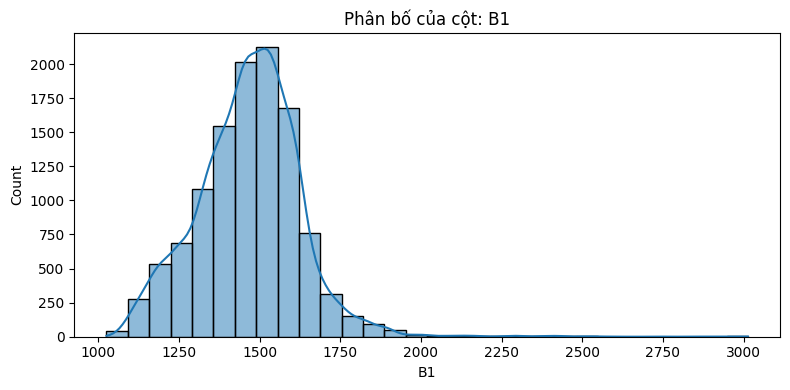

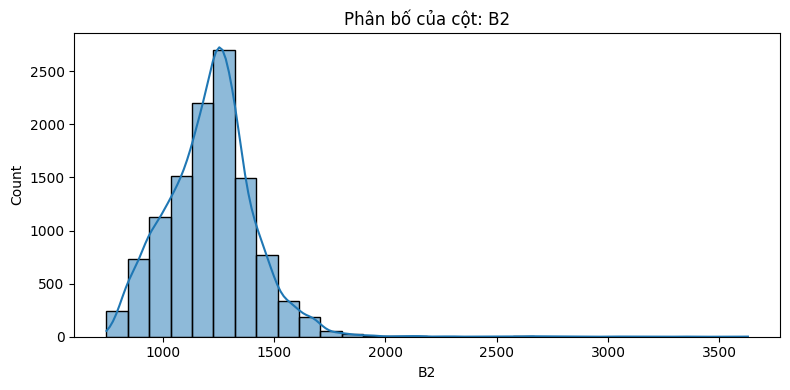

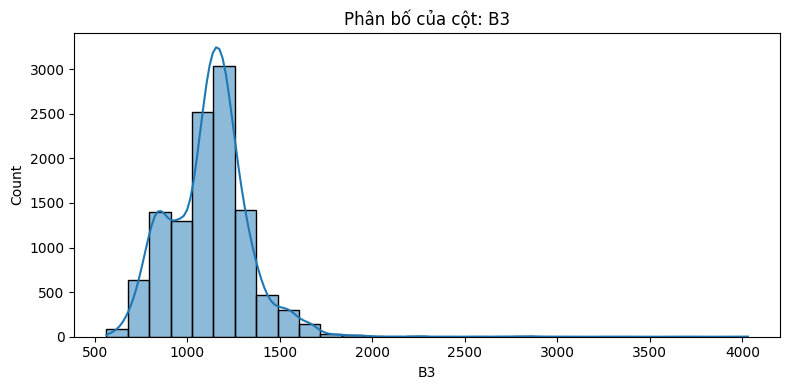

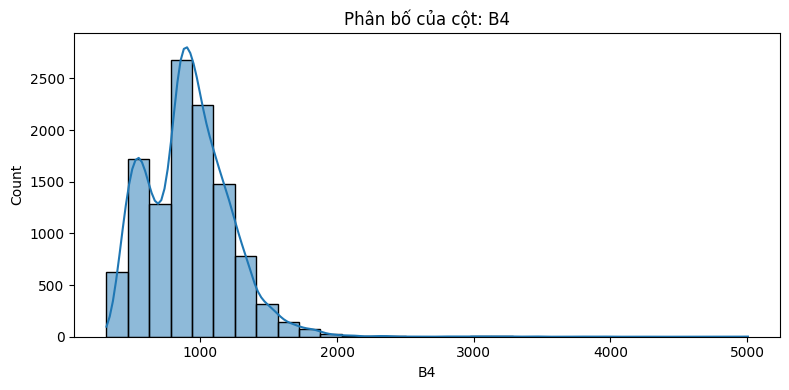

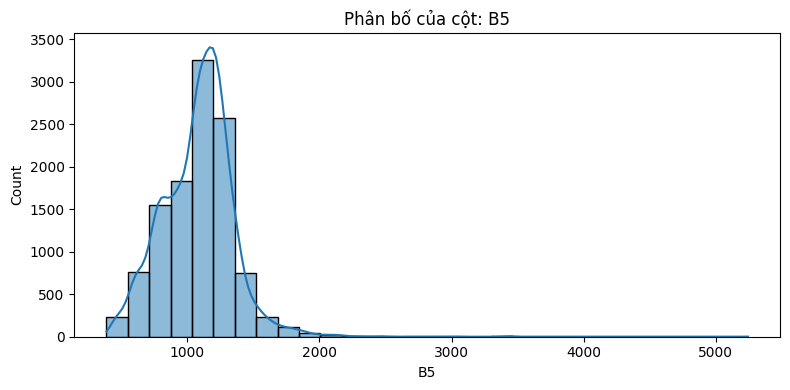

...

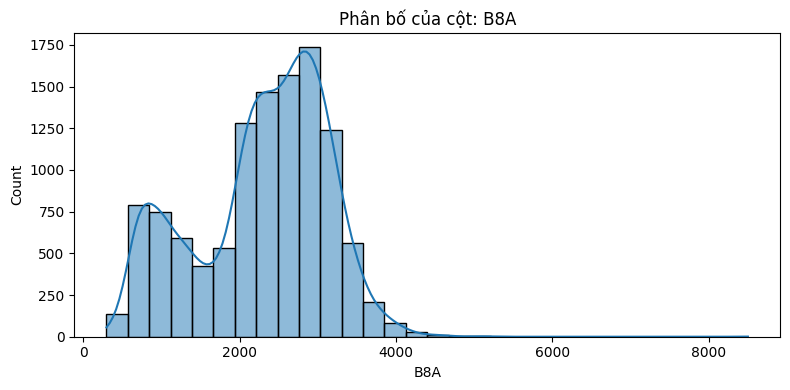

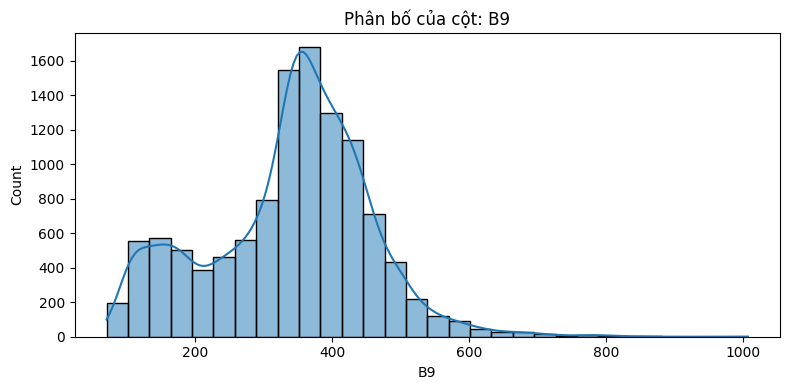

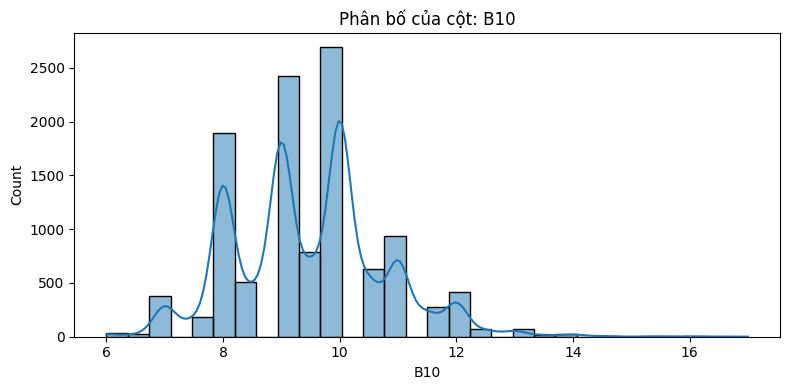

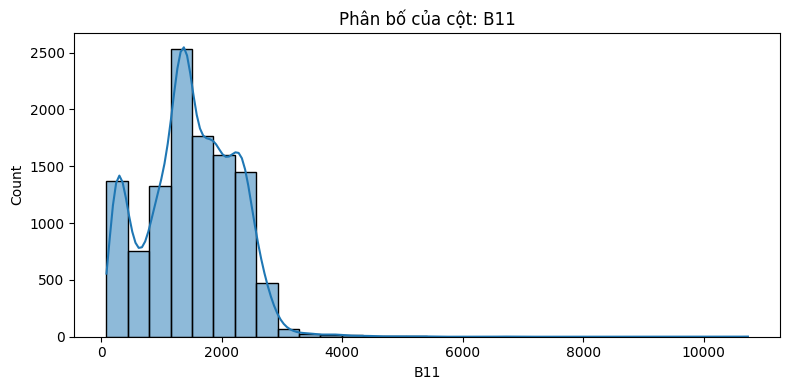

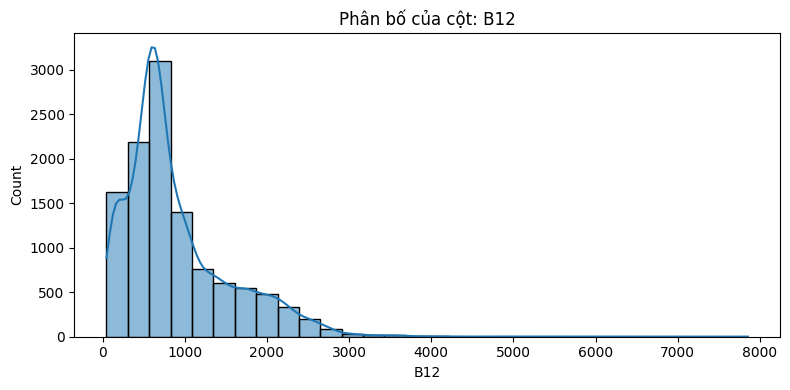

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

for ft in get_all_features(df_train):
    plt.figure(figsize=(8, 4))  
    sns.histplot(df_train[ft].dropna(), bins=30, kde=True)
    plt.xlabel(ft)
    plt.title(f"Phân bố của cột: {ft}")
    plt.tight_layout()
    plt.show() 

### Nhận xét nhỏ
Phân bố của các cột đều bị lệch phải (right skewed) khá mạnh. Điều này sẽ gây tác động tiêu cực tới các mô hình giả định dữ liệu phân phối chuẩn, vì vậy cần phải thực hiện xử lý skew trước khi huấn luyện mô hình. Có các phương pháp phổ biến để giảm bớt skew gồm có `Log Transform`, `Box-Cox transform`, `Power Transform`, v.v. Cách quantile của HDD cũng ổn nhưng mà chưa thử


### Display boxplot trên từng cột, label

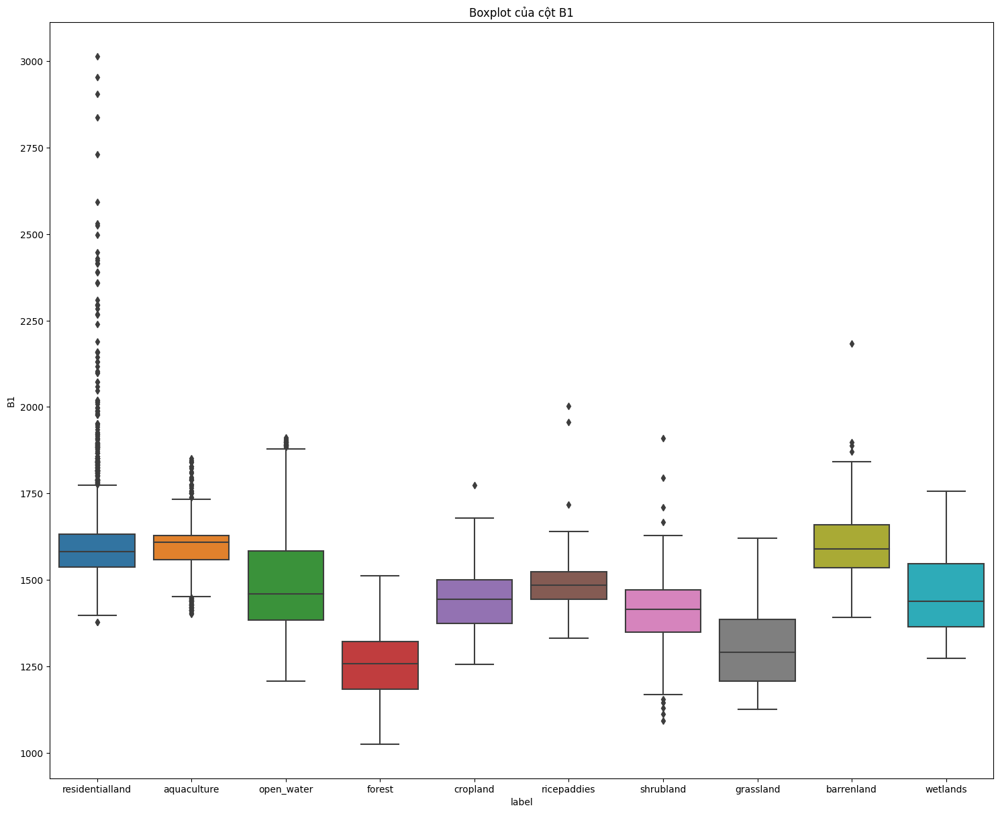

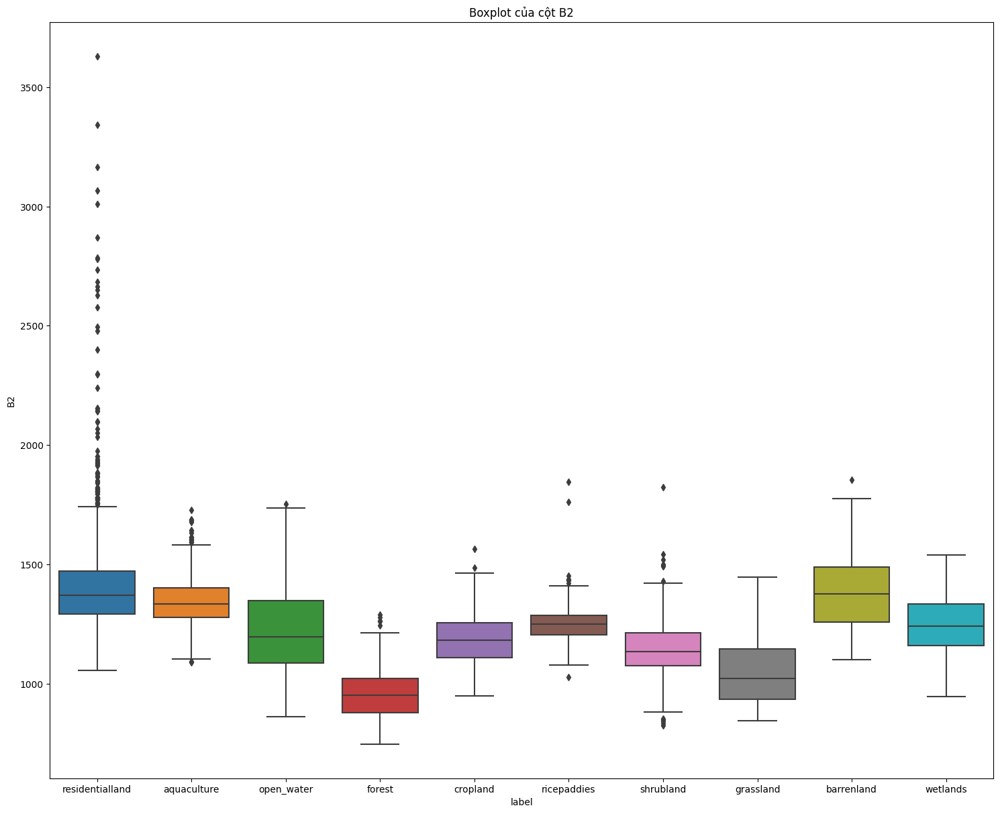

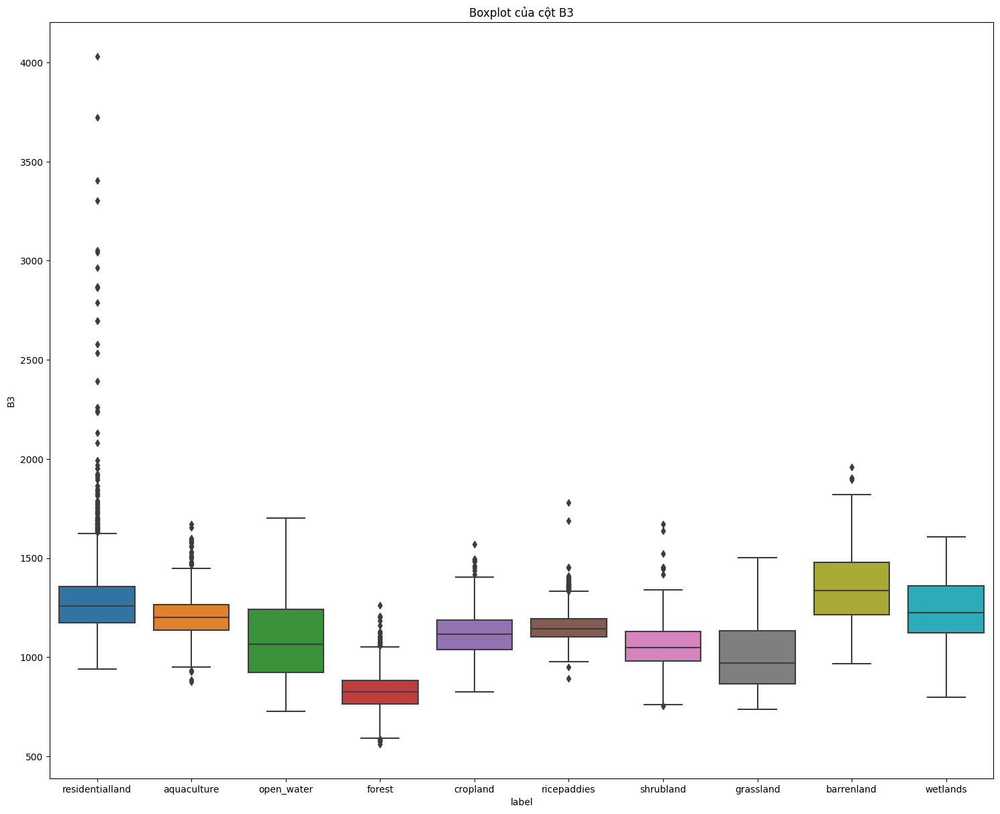

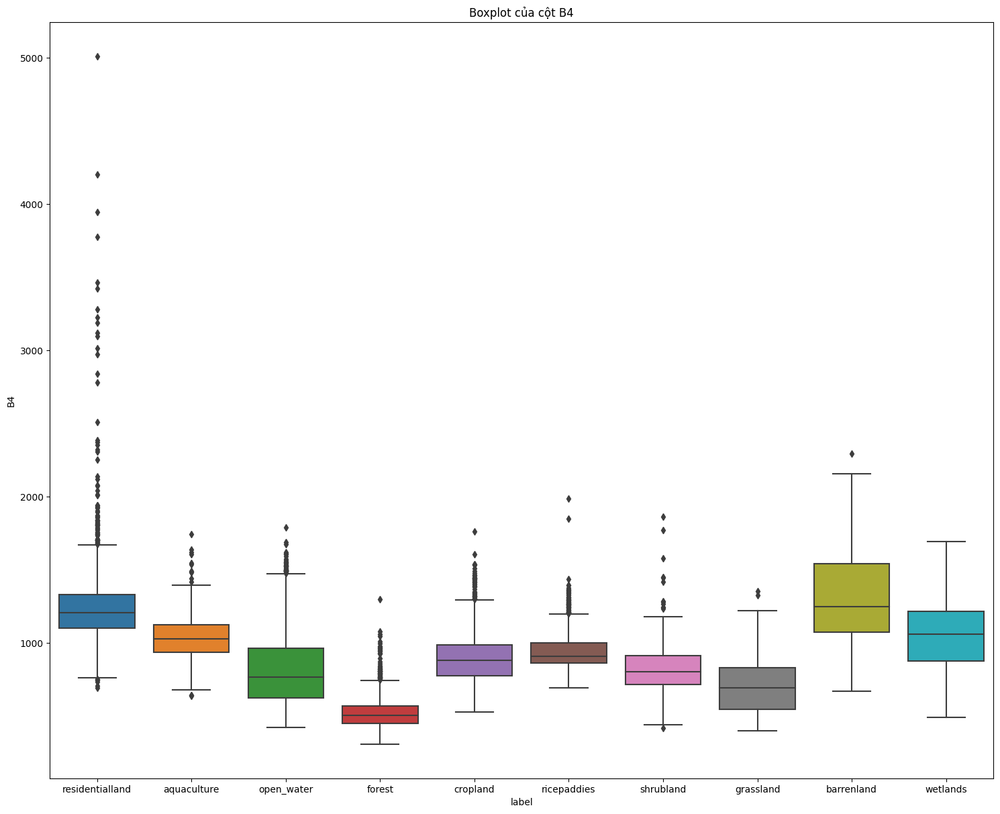

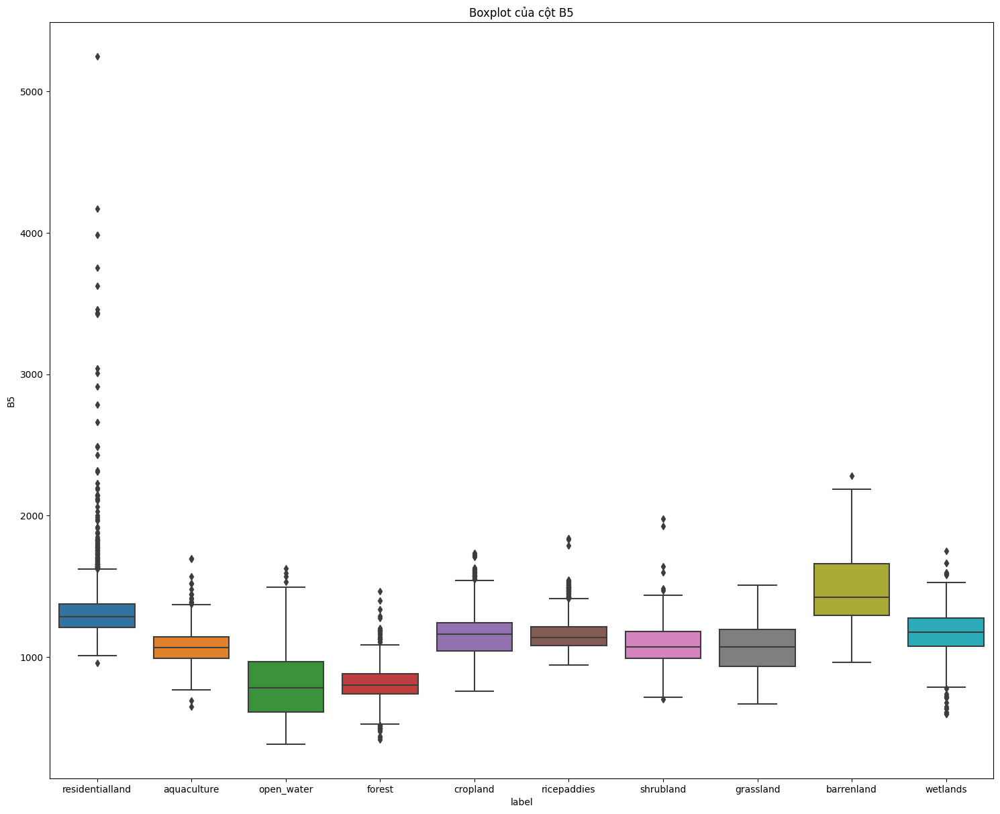

...

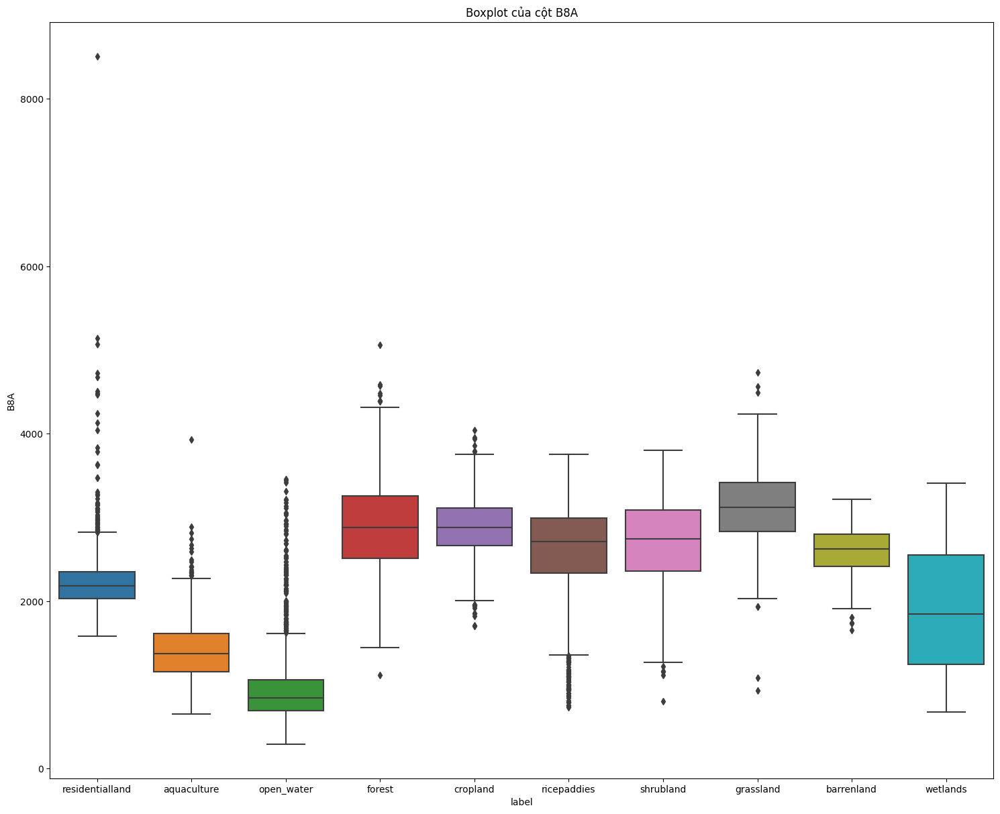

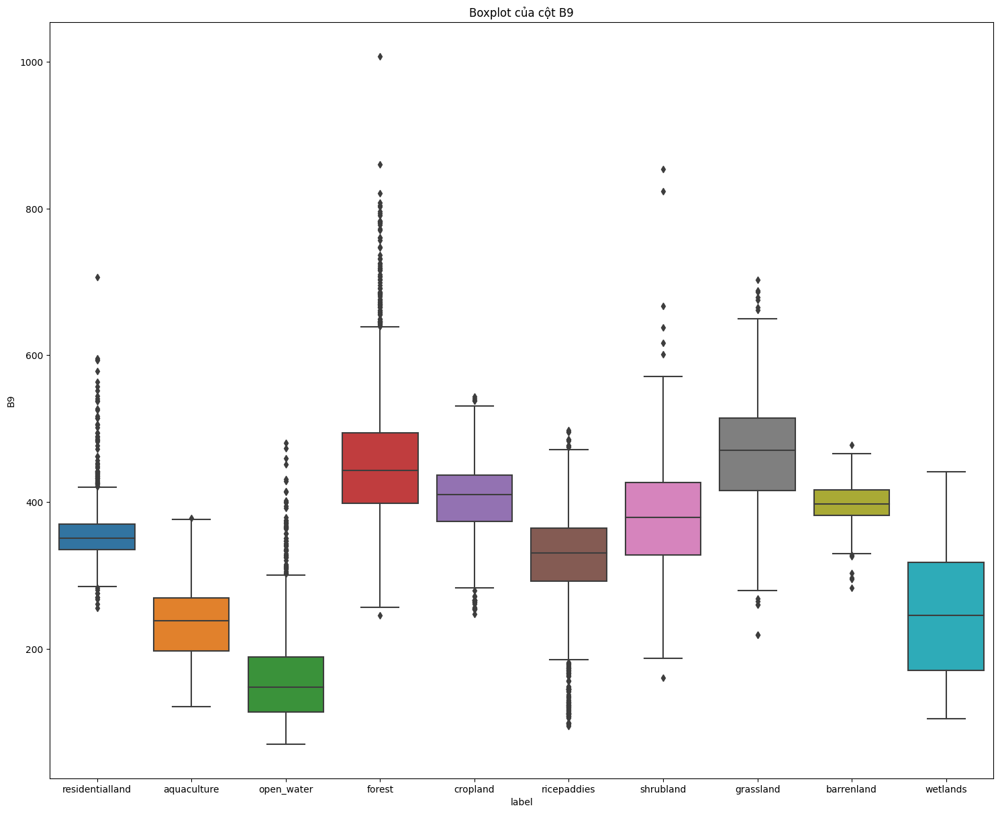

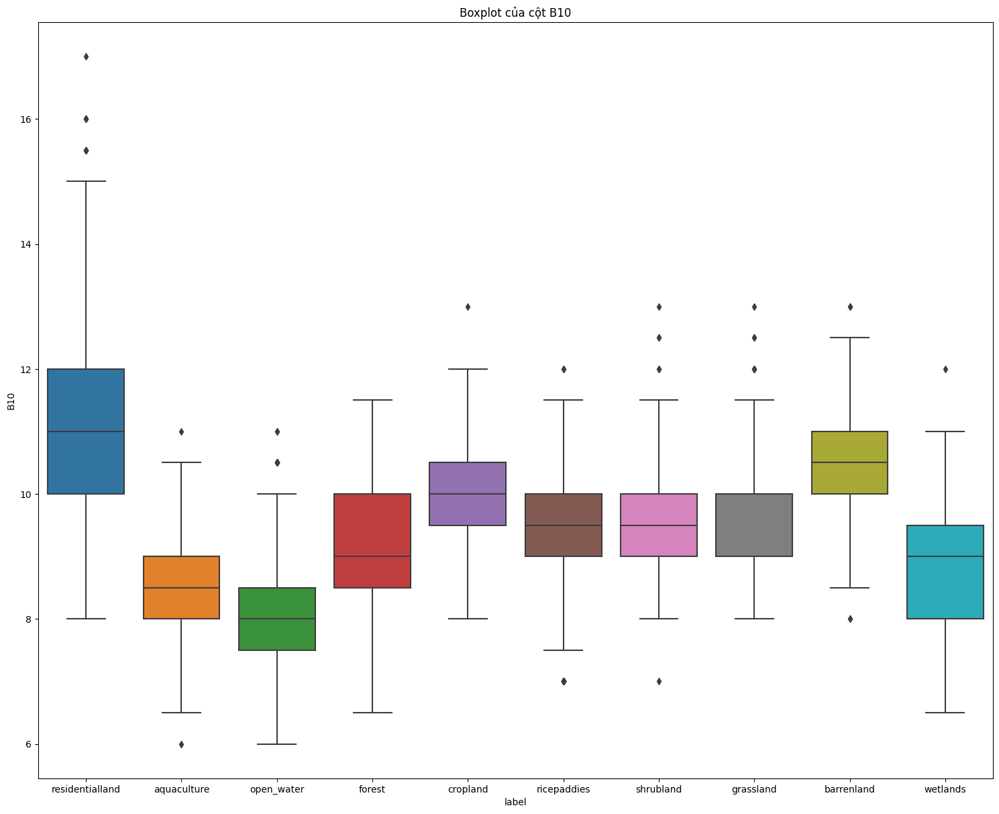

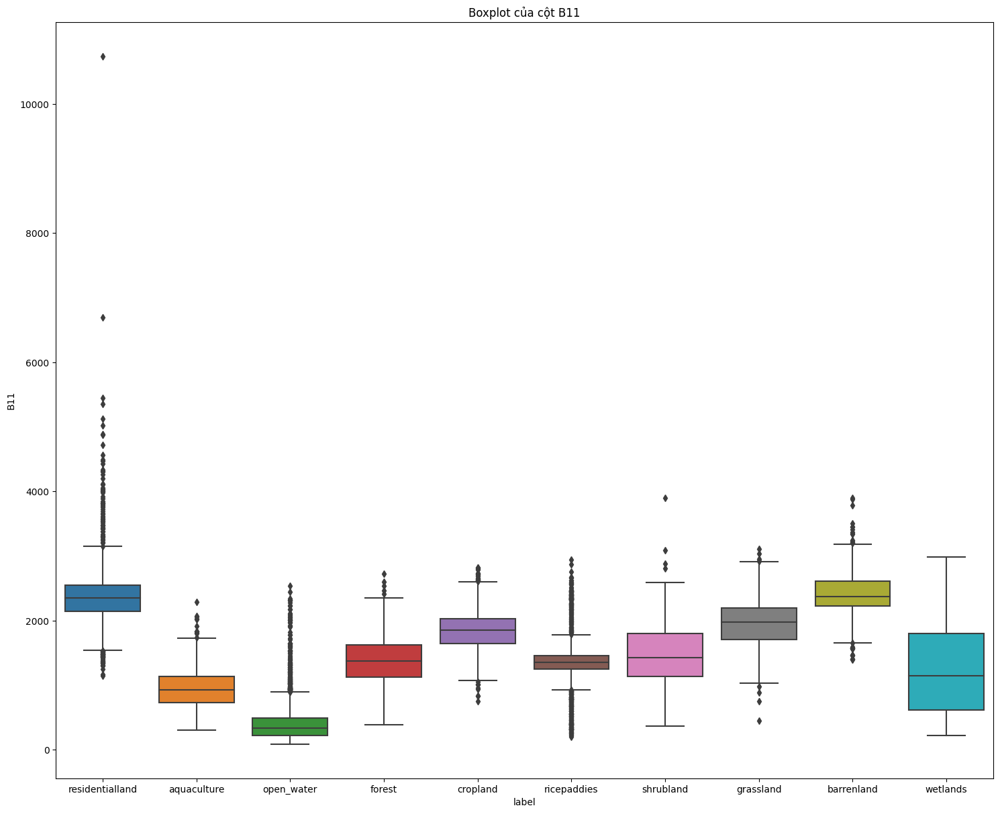

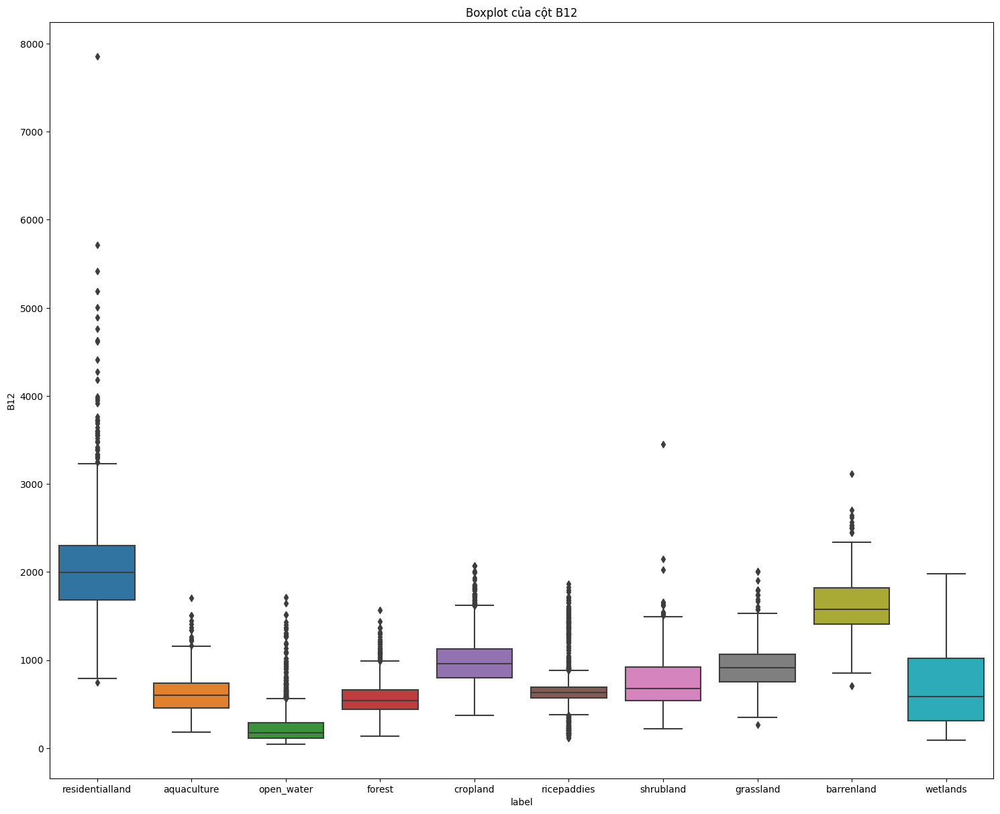

In [14]:
for ft in get_all_features(df_train):
    plt.figure(figsize=(15, 12))
    sns.boxplot(x='label', y=ft, data=df_train)
    plt.tight_layout()
    plt.title(f"Boxplot của cột {ft}")
    plt.show()

### Nhận xét
- Có nhiều outlier ở label `residentialland` trên mọi cột. Dự đoán của nhóm về hiện tượng này là do dữ liệu lấy ở nhiều vùng dân cư khác nhau, cả nông thôn và thành thị. Cộng kèm với nguyên vật liệu phản xạ cũng là một phần nguyên do, các bề mặt như nhà cửa, đường sá, công trình xây dựng và các vật liệu nhân tạo có đặc tính phản xạ khác nhau dẫn đến việc tín hiệu phản xạ không đồng nhất và tạo ra sự nhiễu cho dữ liệu vệ tinh. Trong các khu vực đô thị, sự thay đổi trong khí quyển cũng có thể diễn ra phức tạp hơn, do các hoạt động công nghiệp, giao thông và xây dựng.

- Median ứng với từng label trong các cột B6, B9, B11, B12 tương đối khác nhau => đây là các cột tiềm năng giúp phân loại land cover

- Boxplot của các label trong cột B2, B3 chồng lấn nhau tương đối nhiều => khó dựa vào các cột này để phân loại land cover

### Violin plot
Dùng violin plot để xem hình dạng phân phối chuẩn hơn (như trong boxplot thì chỉ tập trung vào median và IQR)sns.violinplot(x='label', y='feature_x', data=df, inner='box')

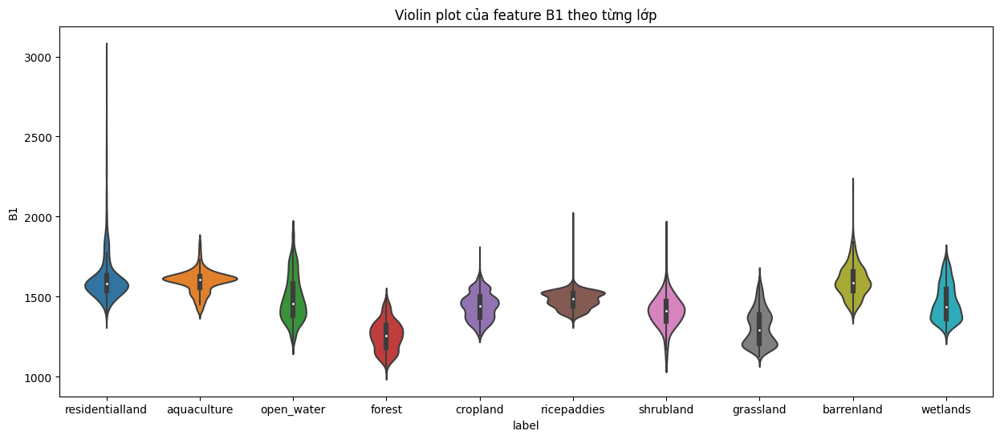

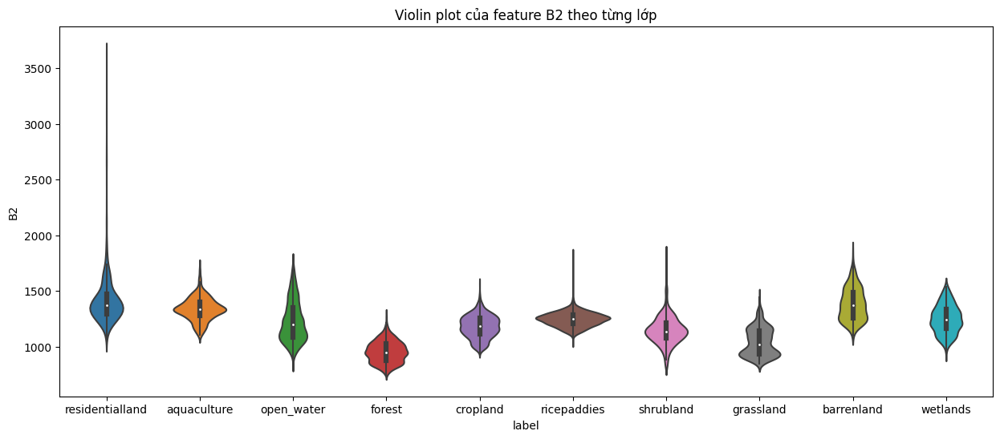

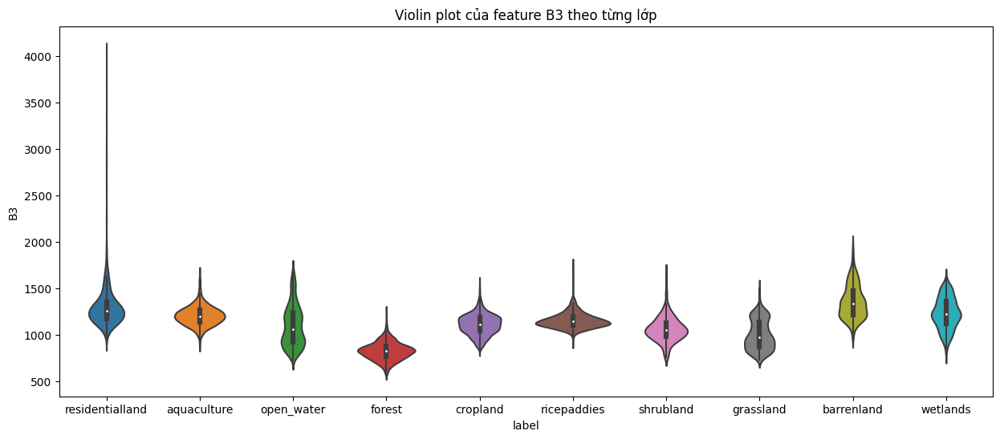

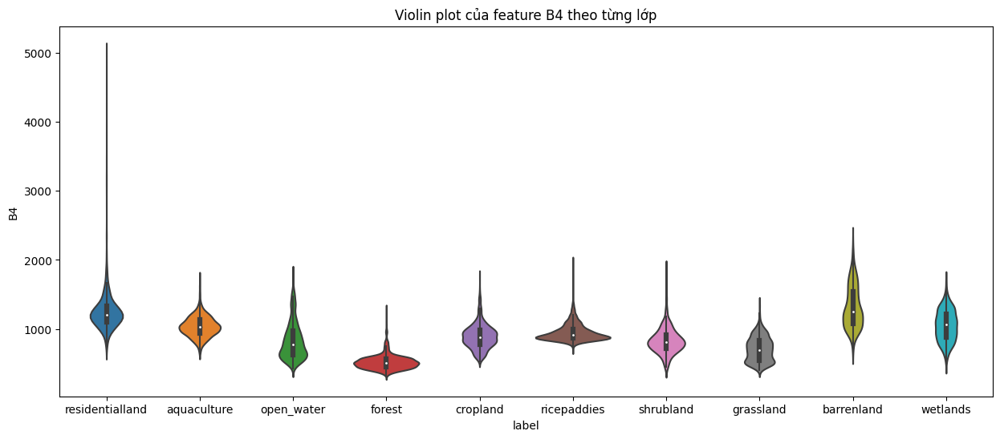

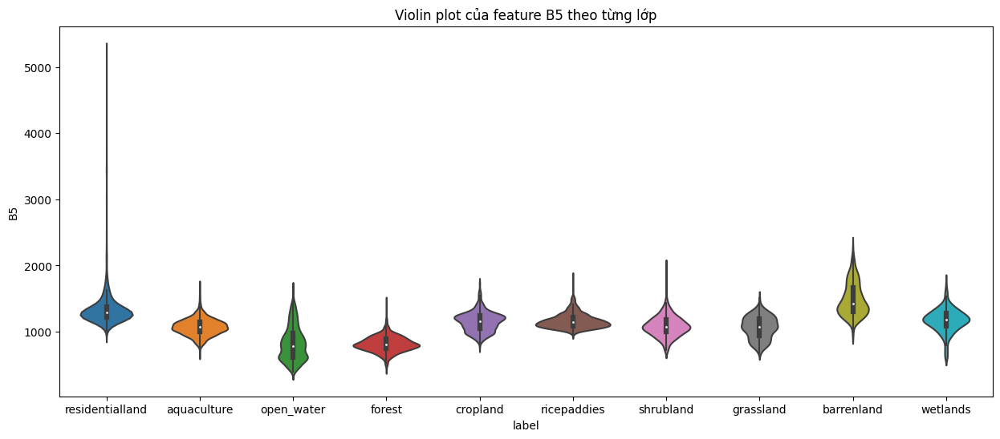

...

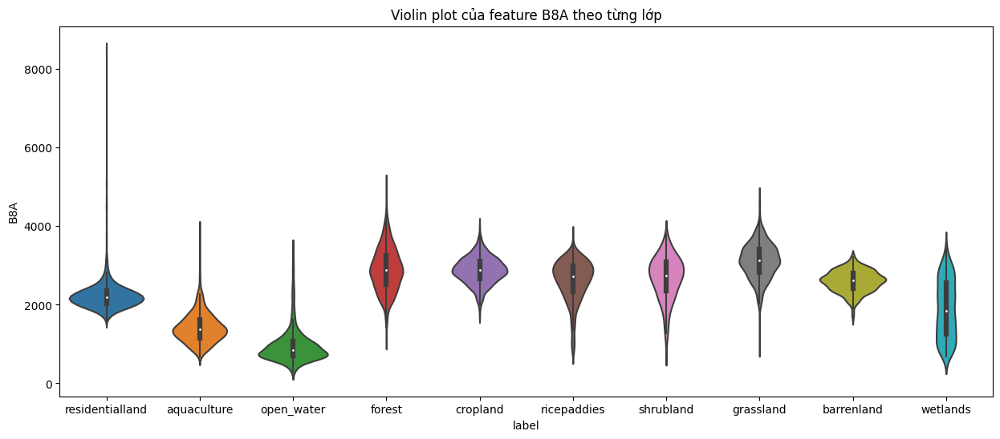

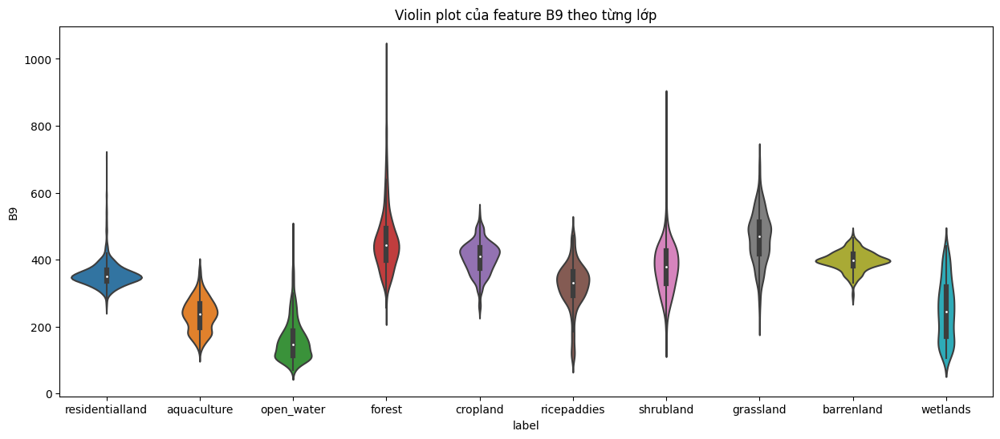

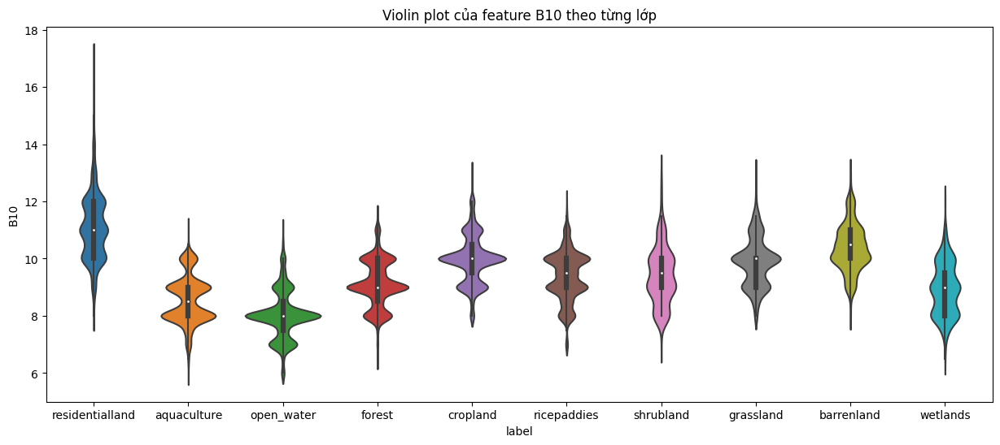

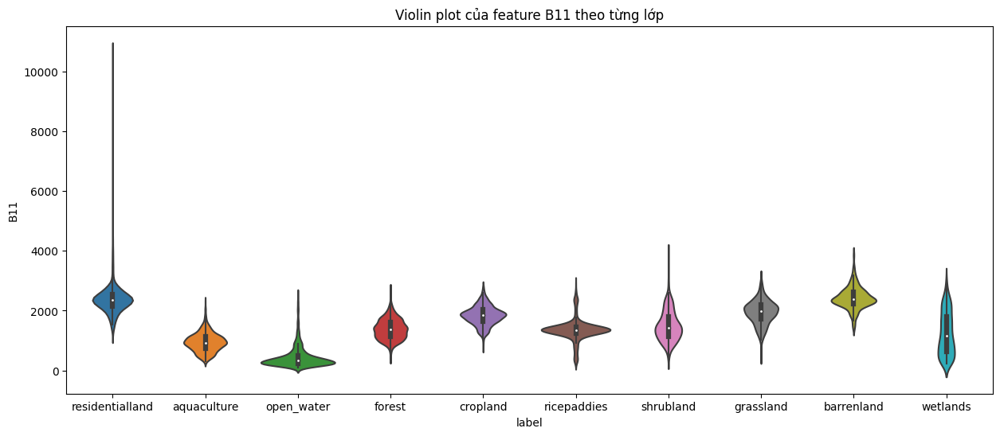

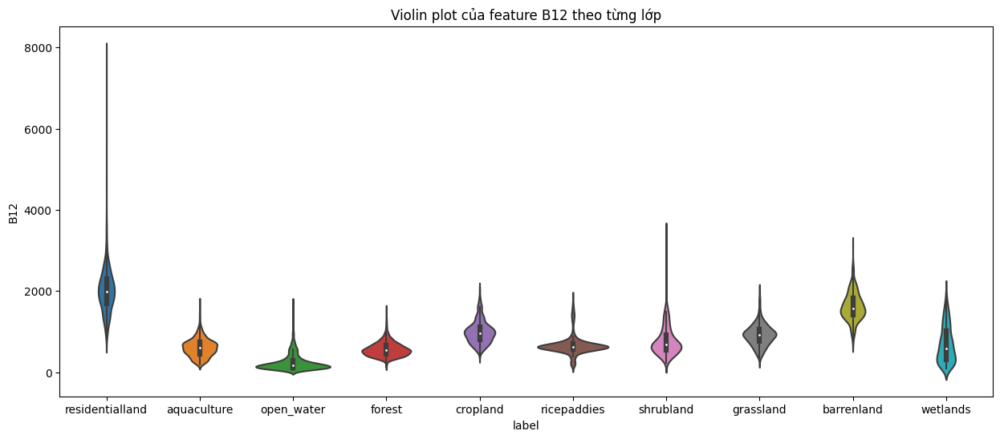

In [15]:
for ft in get_all_features(df_train):
    plt.figure(figsize=(15,6))
    sns.violinplot(x='label', y=ft, data=df_train, inner='box')
    plt.title(f'Violin plot của feature {ft} theo từng lớp')
    plt.show()

### Nhận xét
- Không có gì đặc biệt lắm, chỉ là `B10` có đa đỉnh trong phân bố  

## Phân tích đa biến (phân tích mối quan hệ)

In [16]:
# sns.pairplot(df_train, vars=get_all_features(df_train), hue='label', corner=True)

In [17]:
def plot_scatter_by_label(df, x_col, y_col, label_col='label', figsize=(8,6)):
    plt.figure(figsize=figsize)
    sns.scatterplot(data=df, x=x_col, y=y_col, hue=label_col, palette='Set2', s=40, edgecolor='k', alpha=0.7)
    plt.title(f'Scatter Plot: {x_col} vs {y_col}')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

import plotly.express as px
# Interactive scatter plot (có thể phóng to thu nhỏ)
def interactive_plot_scatter_by_label(df, x_col, y_col, label_col='label', figsize=(8,6)):
    fig = px.scatter(
        df,
        x=x_col,
        y=y_col,
        color=label_col,
        title=f"{x_col} vs {y_col} by {label_col}",
        width=800,
        height=600,
        opacity=0.7
    )
    fig.update_traces(marker=dict(size=6, line=dict(width=0.5, color='DarkSlateGrey')))
    fig.update_layout(legend_title=label_col)
    fig.show()

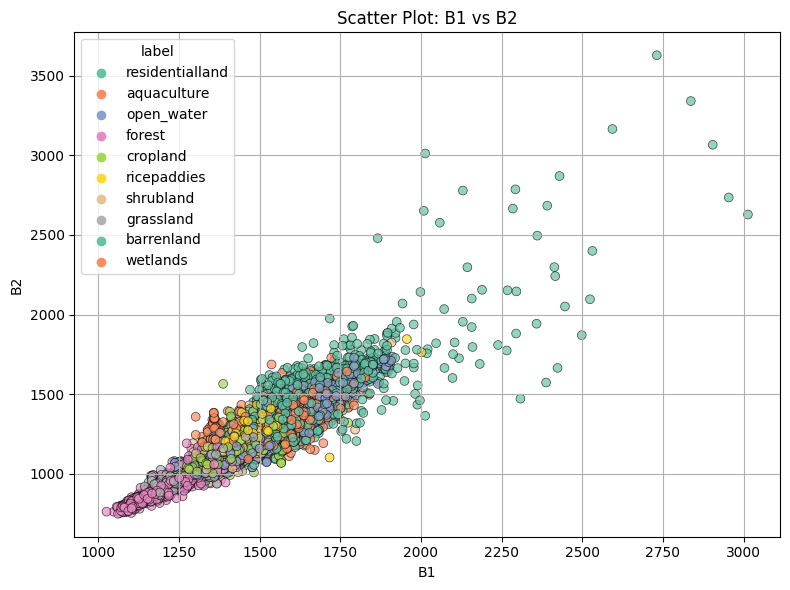

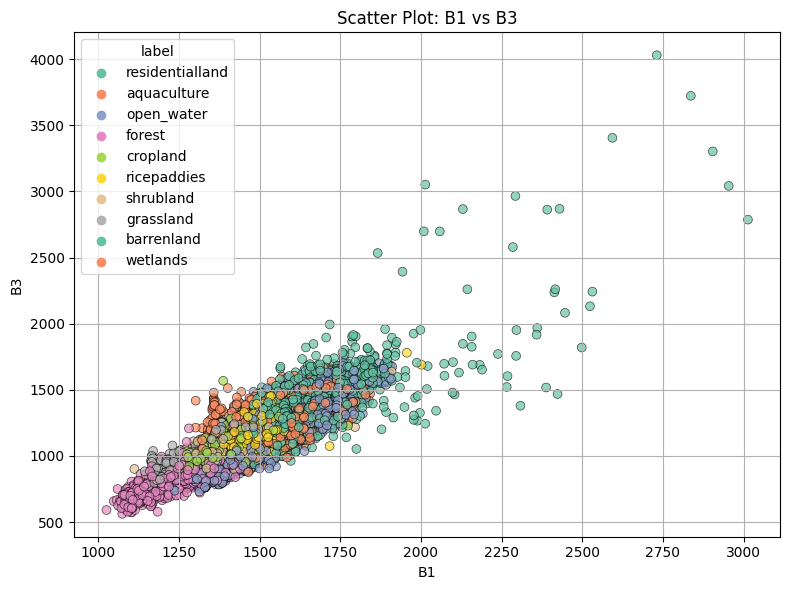

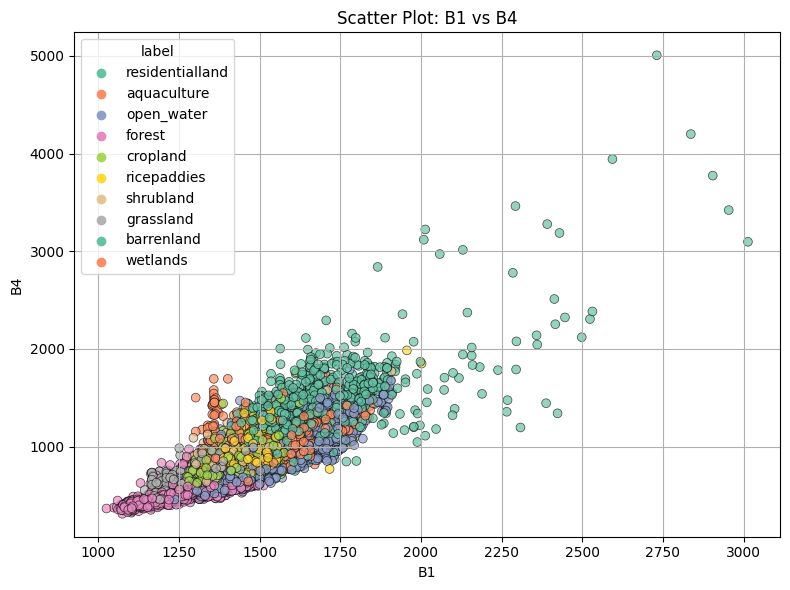

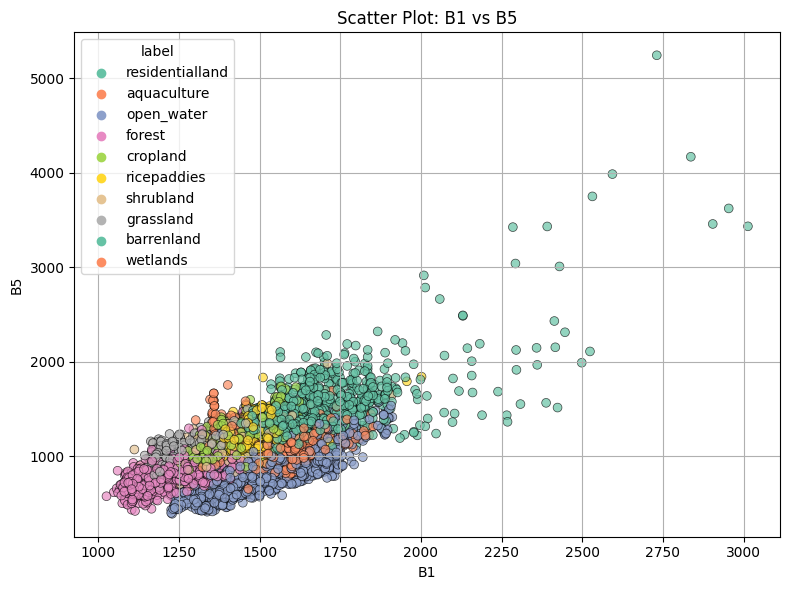

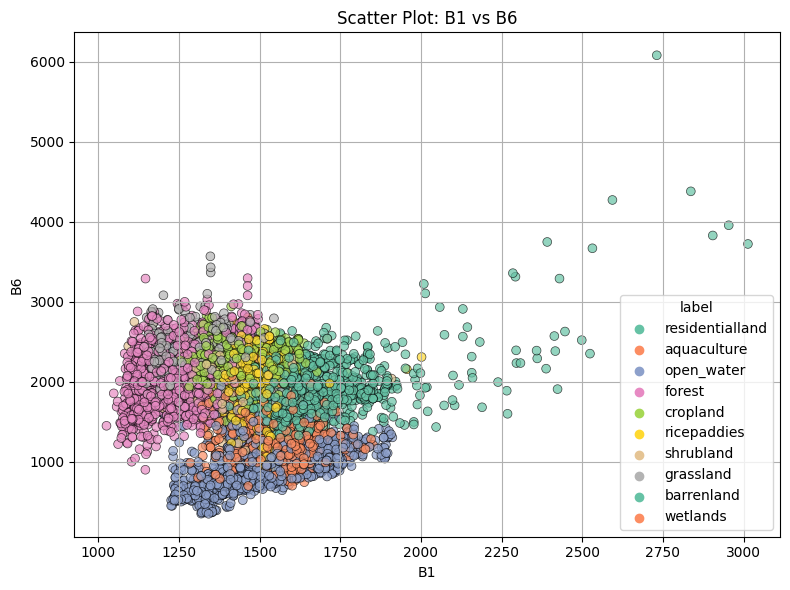

...

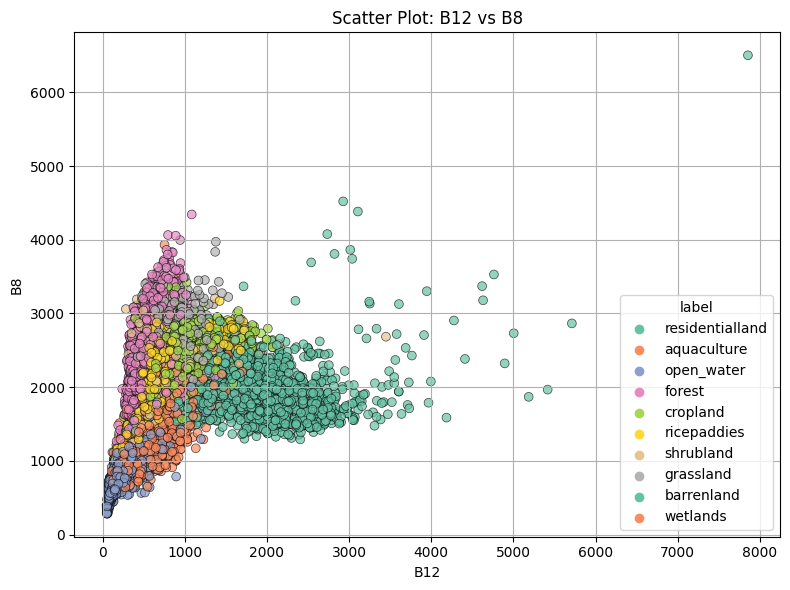

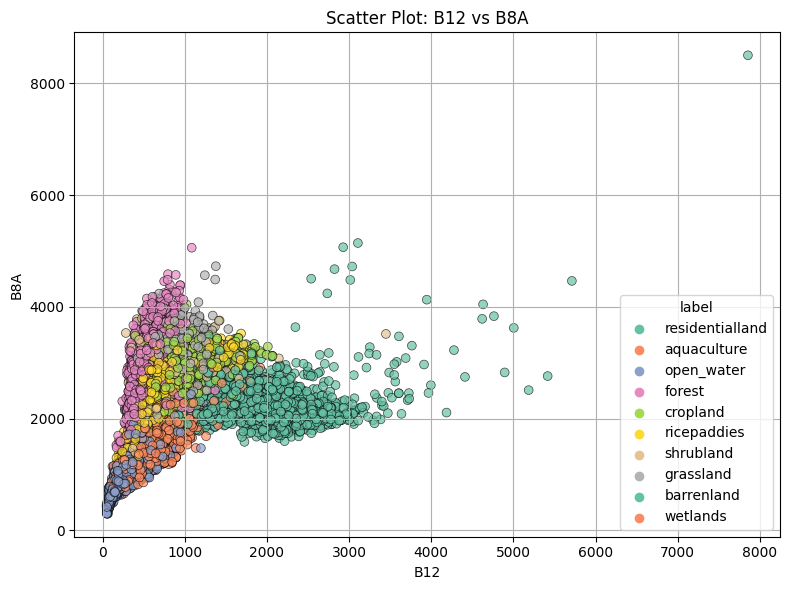

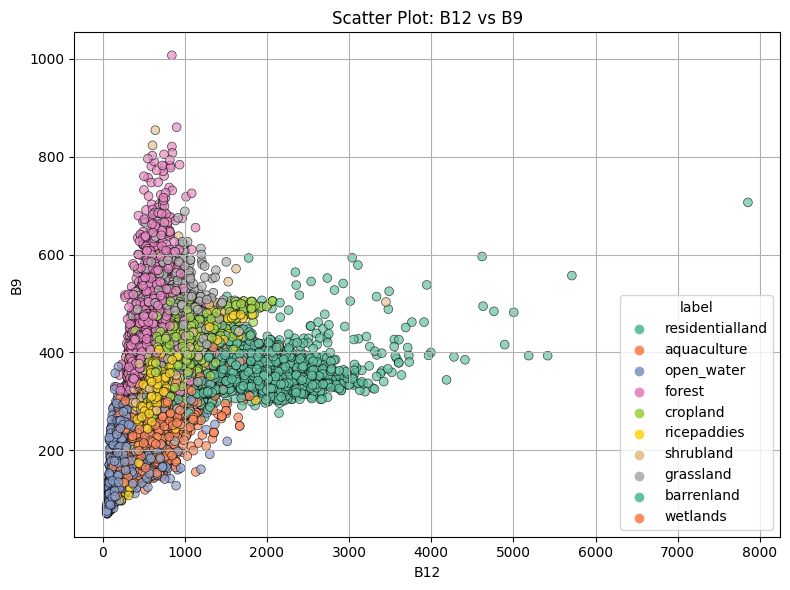

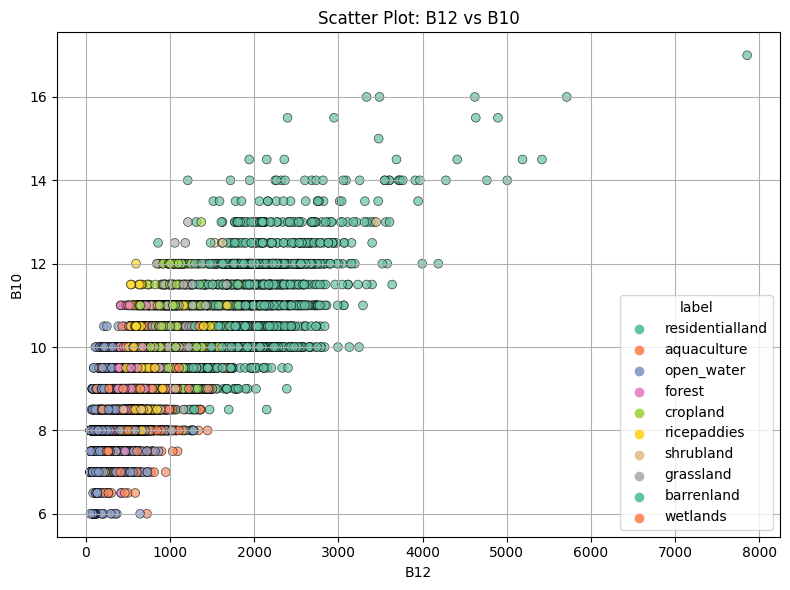

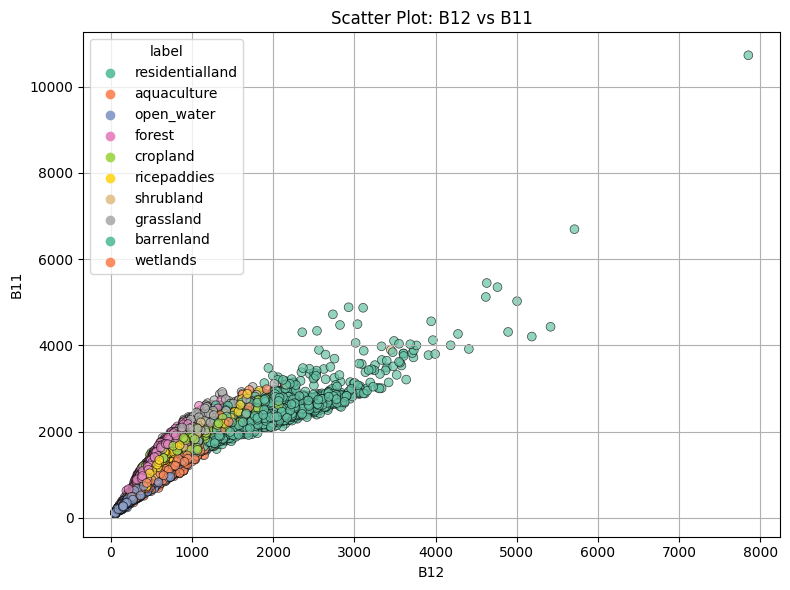

In [18]:
for ft in get_all_features(df_train):
    for other_ft in get_all_features(df_train):
        if ft == other_ft:
            continue
        plot_scatter_by_label(df_train, ft, other_ft)

In [19]:
interactive_plot_scatter_by_label(df_train, 'B2', 'B3')

In [20]:
from sklearn.manifold import TSNE
def plot_tsne(df, label_col='label'):
    features = df[get_all_features(df)]
    labels = df[label_col]
    tsne = TSNE(n_components=2, random_state=42)
    tsne_result = tsne.fit_transform(features)
    df_tsne = pd.DataFrame(tsne_result, columns=['TSNE1', 'TSNE2'])
    df_tsne[label_col] = labels
    fig = px.scatter(df_tsne, x='TSNE1', y='TSNE2', color=label_col, title='t-SNE projection')
    fig.show()

In [21]:
plot_tsne(df_train)

### Nhận xét
- Open_water (xanh lá đậm) nằm khá tách biệt ở góc trái dưới
- Forest (tím nhạt), Residentalland (xanh nước biển đậm) dễ nhận diện
- cropland (cam), ricepaddies (xanh ngọc), grassland (xám), barrenland (hồng nhạt) đang đan xen khá nhiều, tức là về mặt phổ thì chúng giống nhau hoặc phân biệt kém với nhau.

Tuấn Anh ơi ông thử thêm UMAP hoặc là thay đổi tham số `perplexity` giúp tôi xem kết quả có khác nhau nhiều không nhé


### Heatmap

Label encoding for label:
aquaculture -> 0
barrenland -> 1
cropland -> 2
forest -> 3
grassland -> 4
open_water -> 5
residentialland -> 6
ricepaddies -> 7
shrubland -> 8
wetlands -> 9


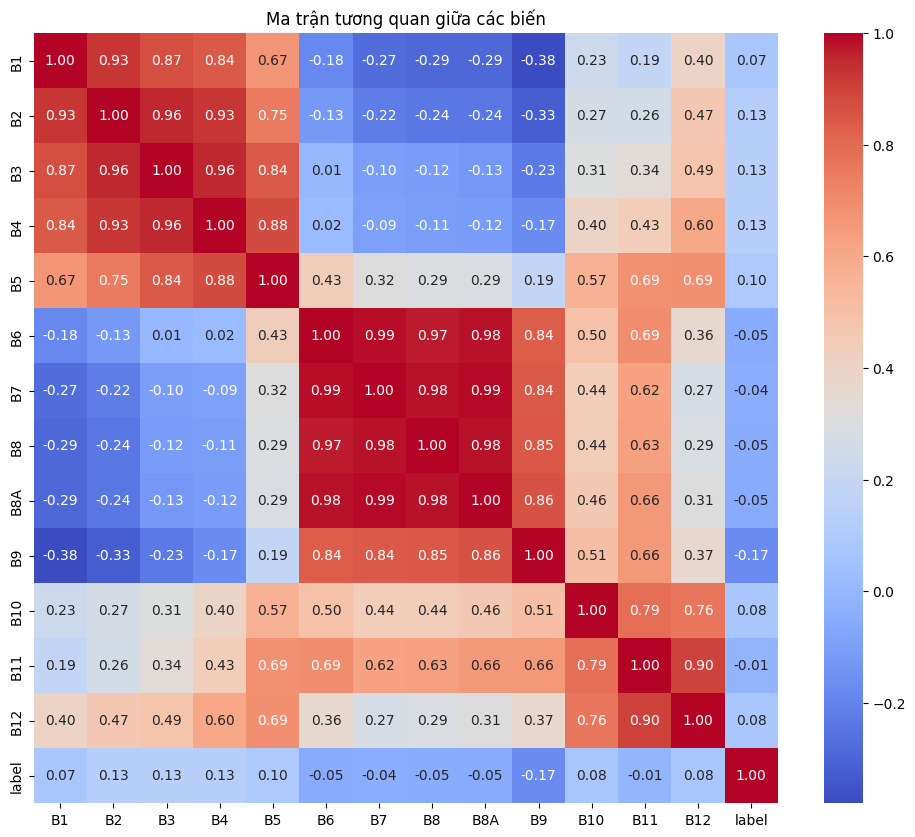

In [22]:
from sklearn.preprocessing import LabelEncoder
def preprocess_data(df):
    dff = df.copy()
    # Drop long, lat
    dff.drop(columns=["long", "lat"], inplace=True, errors='ignore') 
    
    # Encode cột label 
    le = LabelEncoder()
    dff['label'] = le.fit_transform(dff['label'])
    print(f"Label encoding for {'label'}:")
    for label, num in zip(le.classes_, range(len(le.classes_))):
        print(f"{label} -> {num}")
    return dff
dff_train = preprocess_data(df_train)
corr = dff_train.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Ma trận tương quan giữa các biến')
plt.show()

### Nhận xét
- Band 2 -> 5: hệ số tương quan cao, có thể chỉ cần giữ lại 2-3 band đại diện
- Band 6 -> 8A: hệ số tương quan cực cao, có thể chỉ cần giữ lại 2 band đại diện

=> Có thể dùng các kĩ thuật Feature Selection để chọn ra các feature quan trọng

- Hầu hết hệ số tương quan giữa các feature với label là cực thấp, điều này cho thấy mối quan hệ tuyến tính giữa từng band đơn lẻ với nhãn là rất yếu
  => Tạo thêm các feature phi tuyến (trình bày ở bước Feature Engineering) và dùng các model capture được mối quan hệ phi tuyến, phức tạp tốt như tree-based model (Random Forest, XGBoost) 



## Feature Engineering

In [23]:
def add_features(df):
    df['NDVI'] = (df['B8'] - df['B4']) / (df['B8'] + df['B4'])
    df['NDWI'] = (df['B3'] - df['B8']) / (df['B3'] + df['B8'])
    df['NDMI'] = (df['B8A'] - df['B11']) / (df['B8A'] + df['B11'])
    df['NDBI'] = (df['B11'] - df['B8']) / (df['B11'] + df['B8'])
    df['BSI'] = ((df['B12'] + df['B8']) - (df['B4'] + df['B3'])) / ((df['B12'] + df['B8']) + (df['B4'] + df['B3']))
    df['EVI'] = 2.5 * (df['B8'] - df['B4']) / (df['B8'] + 6 * df['B4'] - 7.5 * df['B2'] + 1)
    L = 0.5
    df['SAVI'] = ((df['B8'] - df['B4']) * (1 + L)) / (df['B8'] + df['B4'] + L) # (Soil Adjusted Vegetation Index) – NDVI hiệu chỉnh ảnh hưởng của đất
    return df

In [24]:
# data_train = pd.read_csv("/kaggle/input/newds123/36_train_data_new.csv")
# data_test = pd.read_csv("/kaggle/input/newds123/36_test_data_new.csv")

In [25]:
# df_merge = pd.concat([data_train, data_test], ignore_index=True)

In [26]:
# redistribution = {
#     'residentialland': 2200,
#     'ricepaddies': 2200,
#     'cropland': 2100,
#     'forest': 2150,
#     'open_water': 2150,
#     'aquaculture': 1200,
#     'grassland': 750,
#     'barrenland': 600,
#     'wetlands': 500,
#     'shrubland': 400,
# }

In [27]:
# df_new = pd.DataFrame()
# for label, cnt in redistribution.items():
#     ldf = df_merge[df_merge['label']==label].iloc[:cnt]
#     df_new = pd.concat([df_new, ldf], ignore_index=True)
# df_new.head()

In [28]:
# df_shuffled = df_new.sample(frac=1, random_state=42).reset_index(drop=True)
# df_shuffled['label'].value_counts()

In [29]:
# import seaborn as sns
# import matplotlib.pyplot as plt
# from sklearn.metrics import (
#     confusion_matrix, accuracy_score,
#     precision_score, recall_score, f1_score,
#     classification_report
# )

# def display_confusion_matrix(y_test, y_pred, model):
#     cm = confusion_matrix(y_test, y_pred)
#     plt.figure(figsize=(6, 4))
#     sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=model.classes_, yticklabels=model.classes_)
#     plt.xlabel('Predicted')
#     plt.ylabel('Actual')
#     plt.title('Confusion Matrix')
#     plt.tight_layout()
#     plt.show()

# def display_result(y_test,y_pred, model):
#     print("📊 Evaluation Metrics:")
#     print("Accuracy :", accuracy_score(y_test, y_pred))
#     print("Precision:", precision_score(y_test, y_pred, average='weighted'))
#     print("Recall   :", recall_score(y_test, y_pred, average='weighted'))
#     print("F1 Score :", f1_score(y_test, y_pred, average='weighted'))
    
#     print("\n📋 Classification Report:\n", classification_report(y_test, y_pred))
#     display_confusion_matrix(y_test, y_pred, model)

In [30]:
# from sklearn.model_selection import train_test_split
# df_try = df_shuffled.drop(columns=['lat','long'])
# from sklearn.preprocessing import LabelEncoder
# def preprocess_data(df):
#     # Drop long, lat
#     df.drop(columns=["Unnamed: 0", "long", "lat"], inplace=True, errors='ignore') 
    
#     # Encode cột label 
#     le = LabelEncoder()
#     df['label'] = le.fit_transform(df['label'])
#     print(f"Label encoding for {'label'}:")
#     for label, num in zip(le.classes_, range(len(le.classes_))):
#         print(f"{label} -> {num}")
# preprocess_data(df_try)
# from sklearn.pipeline import Pipeline
# from sklearn.preprocessing import PowerTransformer, StandardScaler

# def apply_scale_pl(X_train, X_test):
#     XX_train, XX_test = X_train.copy(), X_test.copy()
#     scale_pl = Pipeline([
#         ("pt", PowerTransformer(method="yeo-johnson", standardize=False)),
#         ("scaler", StandardScaler()),
#     ])
#     XX_train = scale_pl.fit_transform(XX_train)
#     XX_test = scale_pl.transform(XX_test)
#     return XX_train, XX_test
# X_train,X_test,y_train,y_test=train_test_split(df_try.drop(columns=['label']),df_try['label'],test_size=0.2,random_state=42,stratify=df_try['label'])
# from sklearn.neighbors import KNeighborsClassifier
# X_train, X_test = apply_scale_pl(X_train, X_test)
# knn = KNeighborsClassifier(n_neighbors=4, weights='distance') # Thêm distance vào tăng 0.01 accuracy
# knn.fit(X_train,y_train)
# y_pred=knn.predict(X_test)
# display_result(y_test,y_pred,knn)

In [31]:
# df_shuffled
# df_shuffled['label'].value_counts()

In [32]:
# df_train, df_test = train_test_split(df_shuffled, test_size=0.2, random_state=42, stratify=df_shuffled['label'])

In [33]:
# df_train.to_csv('train.csv', index=False)
# df_test.to_csv('test.csv', index=False)